In [1]:
import torch
import torchvision
import numpy as np
import pandas as pd
import os
import cv2
import time
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from IPython.display import clear_output

from torch.utils.data import Dataset, DataLoader
from torch import nn

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
from torchvision.utils import draw_bounding_boxes
import torchvision.transforms as T

from torchvision.ops.boxes import nms

Воспользуемся мозаичной аугментацией:

In [2]:
!git clone https://github.com/prymeka/mosaic-augmentation-pytorch.git mosaic_augmentation

fatal: destination path 'mosaic_augmentation' already exists and is not an empty directory.


# Создание датасета

In [3]:
df_train = pd.read_csv('isaid_yolov5/train.csv')
df_val = pd.read_csv('isaid_yolov5/val.csv')

print(f'Число изображений в тренировочной выборке: {df_train["filename"].nunique()}')
print(f'Число изображений в валидационной выборке: {df_val["filename"].nunique()}')

df_val

Число изображений в тренировочной выборке: 7975
Число изображений в валидационной выборке: 2613


,filename,xmin,ymin,xmax,ymax,class
0,P0003_0_0.jpg,464,653,487,674,1
1,P0003_0_0.jpg,200,384,256,427,2
2,P0003_0_0.jpg,223,557,281,597,2
3,P0003_0_0.jpg,567,526,623,549,2
4,P0003_0_0.jpg,531,580,629,603,2
...,...,...,...,...,...,...
118379,P2802_5_6.jpg,565,595,599,616,3
118380,P2802_5_6.jpg,258,0,273,5,3
118381,P2802_5_6.jpg,0,44,139,232,4
118382,P2802_5_6.jpg,185,25,313,174,4


In [4]:
df_train['bbox'] = df_train[['xmin', 'ymin', 'xmax' , 'ymax']].apply(list, axis=1)
df_val['bbox'] = df_val[['xmin', 'ymin', 'xmax' , 'ymax']].apply(list, axis=1)

df_train = df_train.drop(columns=['xmin', 'ymin', 'xmax' , 'ymax']).groupby('filename', as_index=False).agg(list)
df_val = df_val.drop(columns=['xmin', 'ymin', 'xmax' , 'ymax']).groupby('filename', as_index=False).agg(list)

In [6]:
df_train

,filename,class,bbox
0,P0000_0_0.jpg,"[2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[907, 140, 935, 157], [967, 53, 968, 69], [92..."
1,P0000_0_1.jpg,"[2, 3]","[[0, 53, 1, 69], [30, 61, 42, 78]]"
2,P0000_0_3.jpg,[4],"[[7, 771, 125, 900]]"
3,P0000_1_0.jpg,"[1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[244, 685, 305, 735], [914, 383, 933, 398], [..."
4,P0000_1_1.jpg,"[2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[276, 75, 293, 99], [184, 848, 200, 864], [25..."
...,...,...,...
7970,P2805_2_0.jpg,"[1, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[776, 623, 821, 669], [195, 535, 212, 549], [..."
7971,P2805_2_1.jpg,"[2, 3, 3, 3, 3, 4, 4, 4, 4]","[[233, 405, 261, 425], [223, 648, 244, 662], [..."
7972,P2805_3_0.jpg,"[2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[821, 134, 846, 172], [440, 667, 481, 689], [..."
7973,P2805_3_1.jpg,"[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[276, 503, 293, 516], [396, 492, 415, 507], [..."


In [5]:
idx2target = {0: 'background',
              1: 'storage_tank',
              2: 'Large_Vehicle',
              3: 'Small_Vehicle',
              4: 'plane',
              5: 'ship',
              6: 'Swimming_pool',
              7: 'Harbor',
              8: 'tennis_court',
              9: 'Ground_Track_Field',
              10: 'Soccer_ball_field',
              11: 'baseball_diamond',
              12: 'Bridge',
              13: 'basketball_court',
              14: 'Roundabout',
              15: 'Helicopter'}

In [6]:
class MyDataset(Dataset):
  
    def __init__(self, dataframe, img_path):
        
        self.df = dataframe
        self.img_path = img_path

    def __len__(self):
        return self.df.shape[0]
  
    def __getitem__(self, index):
        img_name = self.df.loc[index,'filename']
        boxes = torch.Tensor(self.df.loc[index, 'bbox']).to(torch.float)
        labels = torch.Tensor(self.df.loc[index, 'class']).to(torch.int64)
        area = (boxes[:, 2] - boxes[:, 0]) * (boxes[:, 3] - boxes[:, 0])
        iscrowd = torch.zeros(labels.shape[0], dtype=torch.int64)

        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['area'] = area
        target['iscrowd'] = iscrowd
        target['image_id'] = torch.tensor([index,])

        img = cv2.imread(os.path.join(self.img_path, img_name))/255.
        img = torch.from_numpy(img).permute(2, 0, 1).to(torch.torch.float)
        return img, target

# Обучение

In [7]:
from mosaic_augmentation.mosaic import Mosaic

In [8]:
mosaic = Mosaic(output_size=1000,
    min_possible_image_area=0.25,
    centre_pad=False,
    crop=True,
    min_visibility=0.02,
    intelligent_resize=True,
    max_aspect_ratio=1.2,
    crop_to_square=False,)

In [9]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [10]:
torch.cuda.empty_cache()

In [10]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [11]:
!pip install torchmetrics[detection]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 7.7 MB/s eta 0:00:00a 0:00:01


In [11]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torchvision.ops import batched_nms


def intersection_over_union(dt_bbox, gt_bbox):
    int_x0 = max(dt_bbox[0], gt_bbox[0])
    int_y0 = max(dt_bbox[1], gt_bbox[1])

    int_x1 = min(dt_bbox[2], gt_bbox[2])
    int_y1 = min(dt_bbox[3], gt_bbox[3])

    intersection = max(int_x1 - int_x0, 0) * max(int_y1 - int_y0, 0)
    dt_area = (dt_bbox[2] - dt_bbox[0]) * (dt_bbox[3] - dt_bbox[1])
    gt_area = (gt_bbox[2] - gt_bbox[0]) * (gt_bbox[3] - gt_bbox[1])

    return intersection / (dt_area + gt_area - intersection)


def apply_nms(orig_prediction, iou_thresh=0.3):
    
    keep = batched_nms(orig_prediction['boxes'], orig_prediction['scores'], orig_prediction['labels'], iou_thresh)

    final_prediction = orig_prediction

    final_prediction['boxes'] = final_prediction['boxes'][keep]
    final_prediction['scores'] = final_prediction['scores'][keep]
    final_prediction['labels'] = final_prediction['labels'][keep]
    
    return final_prediction


@torch.inference_mode()
def visualize(model, batch):
    model.eval()
    
    to_pil = T.ToPILImage()
    to_tensor = T.PILToTensor()

    xs, ys = batch

    for i, (x, y) in enumerate(zip(xs, ys)):
        prediction = {k: v.to(device) for k, v in model([x.to(device)])[0].items()}

        prediction = apply_nms(prediction)

        x = to_tensor(to_pil(x.cpu()))

        true_boxes = draw_bounding_boxes(x, boxes=y['boxes'], labels=[idx2target[label.item()] for label in y['labels']], width=1, colors='lime')
        predicted_boxes = draw_bounding_boxes(x, boxes=prediction['boxes'], labels=[idx2target[label.item()]+' '+str(round(score.item(),2)) for label, score in zip(prediction['labels'], prediction['scores'])], width=1, colors='lime')
        
        fig, ax = plt.subplots(1, 2, figsize=(20, 10), facecolor='white')

        ax[0].imshow(to_pil(true_boxes))
        ax[1].imshow(to_pil(predicted_boxes))

        ax[0].axis('off')
        ax[1].axis('off')

        ax[0].set_title('Target boxes')
        ax[1].set_title('Predicted boxes')

        plt.subplots_adjust(wspace=0, hspace=0.1)
        plt.show()

        if i >= 9:
            break

In [12]:
def train(model):
    model.train()
    loss_log = []
    for x, y in tqdm(train_loader, desc='Train'):
        x, y = mosaic(x, y)
        x = list(_.to(device).float() for _ in x)
        y = [{k: v.to(device) for k, v in t.items()} for t in y]

        optimizer.zero_grad()
        try:
            output = model(x, y)
        except:
            continue
        
        loss_sum = sum(loss for loss in output.values())

        loss_sum.backward()

        optimizer.step()
        
        loss_log.append(loss_sum.item())
    return np.mean(loss_log)

def val(model):
    loss_log = []
    for x, y in tqdm(valid_loader, desc='Val'):
        x, y = mosaic(x, y)
        x = list(_.to(device).float() for _ in x)
        y = [{k: v.to(device) for k, v in t.items()} for t in y]

        optimizer.zero_grad()

        try:
            with torch.no_grad():
                output = model(x, y)
        except:
            continue
        
        loss_sum = sum(loss for loss in output.values())
        
        loss_log.append(loss_sum.item())
    return np.mean(loss_log)

In [13]:
@torch.inference_mode()
def evaluate(model, loader):
    model.eval()
    
    metric = MeanAveragePrecision(class_metrics=True)

    for x, y in tqdm(loader, desc='Evaluation'):
        x = list(_.to(device).float() for _ in x)

        output = model(x)
        
        output = [{k: v.cpu() for k, v in t.items()} for t in output]

        metric.update(output, y)

    return metric.compute()

In [14]:
def plot_stats(
    train_map,
    valid_map,
    title
):
    plt.figure(figsize=(16, 8))

    plt.title(title + ' mAP')
    
    plt.plot(train_map, label='Train mAP')
    plt.plot(valid_map, label='Valid mAP')
    plt.legend()
    plt.grid()

    plt.show()
    
def plot_train(
    train_losses,
    valid_losses,
    title
):
    plt.figure(figsize=(16, 8))

    plt.title(title + ' loss')
    
    plt.plot(train_losses, label='Train loss')
    plt.plot(valid_losses, label='Valid loss')
    plt.legend()
    plt.grid()

    plt.show()

In [15]:
def whole_train_valid_cycle(model, num_epochs, title, scheduler=None):
    batch = next(iter(valid_loader))
    
    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        print(f'Epoch: {epoch}')
        
        train_loss = train(model)
        val_loss = val(model)
        train_losses.append(train_loss)
        val_losses.append(val_loss)

        clear_output()

        visualize(model, batch)
        
        plot_train(train_losses, val_losses, title)
        
        if scheduler is not None:
            scheduler.step()

In [16]:
from torchvision.models.detection import fasterrcnn_mobilenet_v3_large_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor


def get_detection_model(trainable_backbone_layers=3):
    model = fasterrcnn_mobilenet_v3_large_fpn(weights='COCO_V1', trainable_backbone_layers=trainable_backbone_layers)
    
    model.roi_heads.box_predictor = FastRCNNPredictor(1024, 16)
    
    return model

In [17]:
train_dataset = MyDataset(df_train, 'isaid_yolov5/train/images')
val_dataset = MyDataset(df_val, 'isaid_yolov5/val/images')

train_loader = DataLoader(
    train_dataset,
    batch_size=8,
    shuffle=True,
    pin_memory=True,
    collate_fn=collate_fn
)

valid_loader = DataLoader(
    val_dataset,
    batch_size=8,
    shuffle=False,
    pin_memory=True,
    collate_fn=collate_fn
)

Вот как работает мозаичная аугментация:

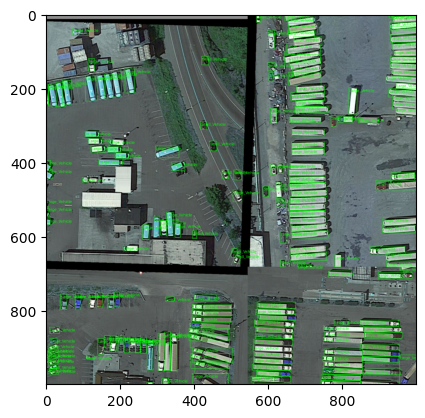

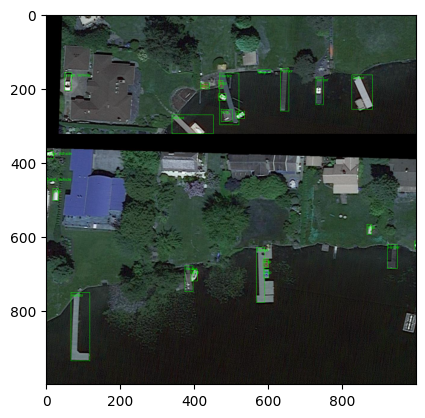

In [23]:
x, y = next(iter(valid_loader))
xs, ys = mosaic(x, y)
to_pil = T.ToPILImage()
to_tensor = T.PILToTensor()
for i, (x, y) in enumerate(zip(xs, ys)):
        x = to_tensor(to_pil(x.cpu()))

        true_boxes = draw_bounding_boxes(x, boxes=y['boxes'], labels=[idx2target[label.item()] for label in y['labels']], width=1, colors='lime')

        plt.imshow(to_pil(true_boxes))
        plt.show()

Модель с trainable_backbone_layers=3:

In [20]:
model = get_detection_model().to(device)

optimizer = torch.optim.Adam([p for p in model.parameters() if p.requires_grad], lr=1e-4)

Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth
100%|██████████| 74.2M/74.2M [00:01<00:00, 73.5MB/s]


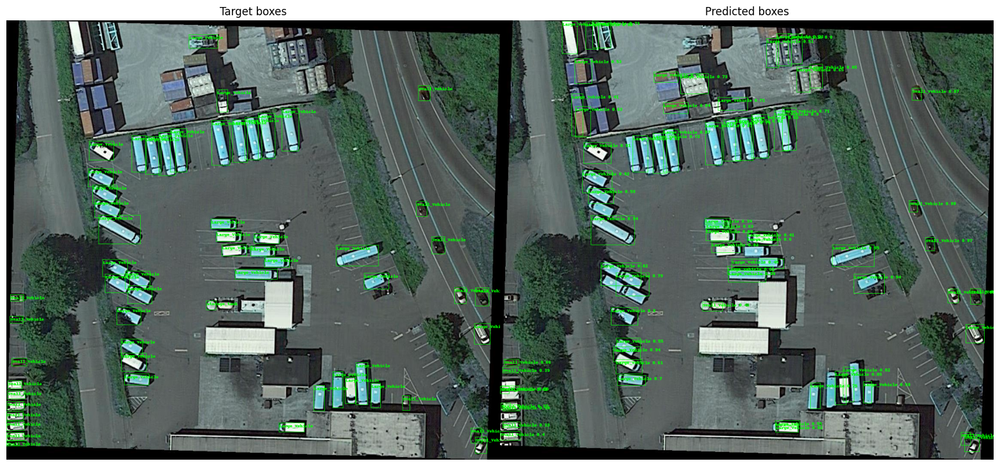

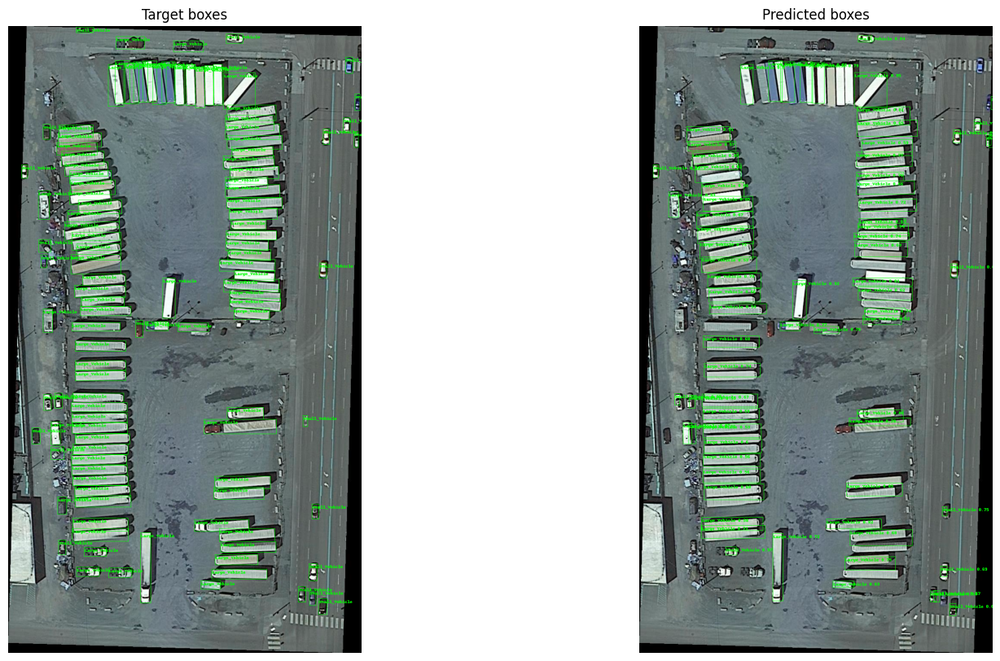

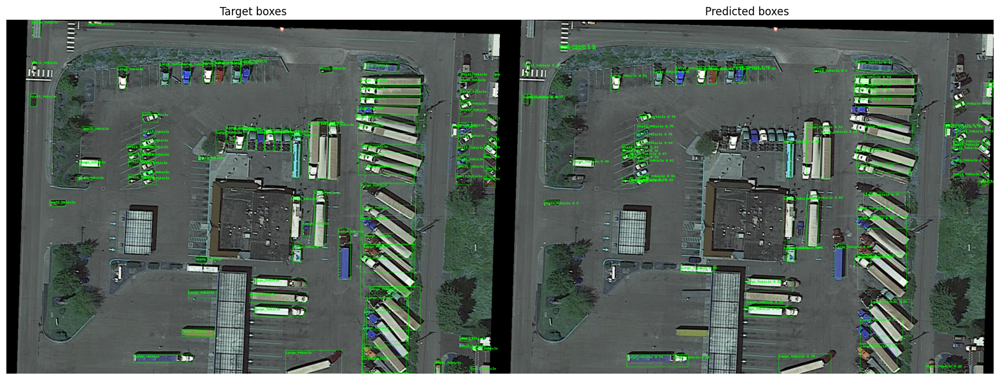

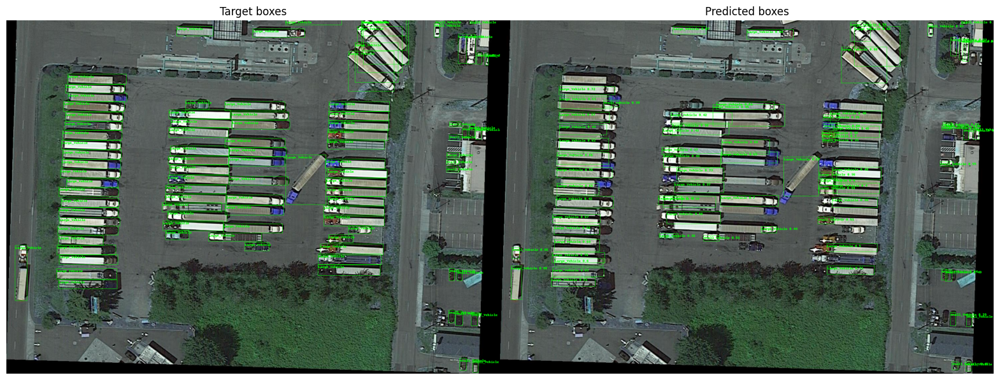

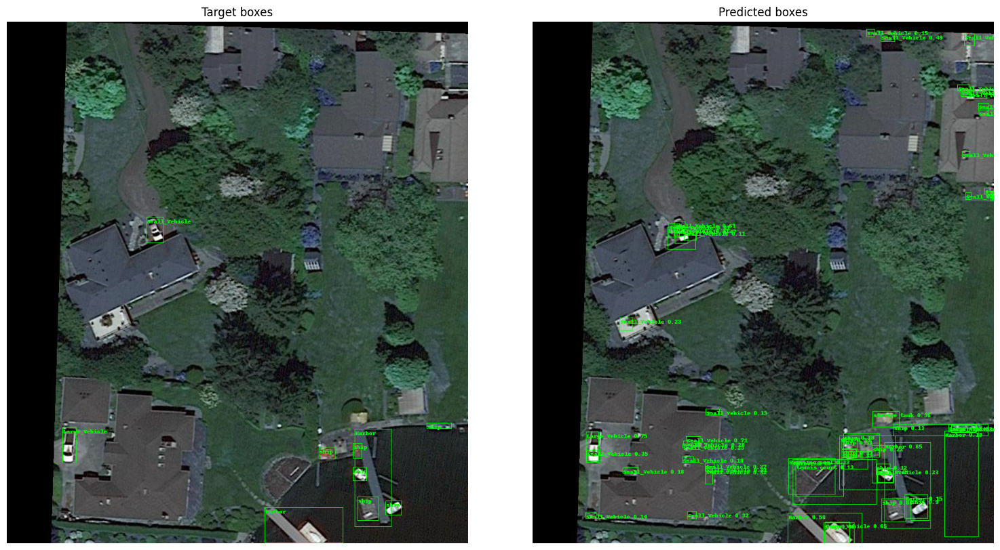

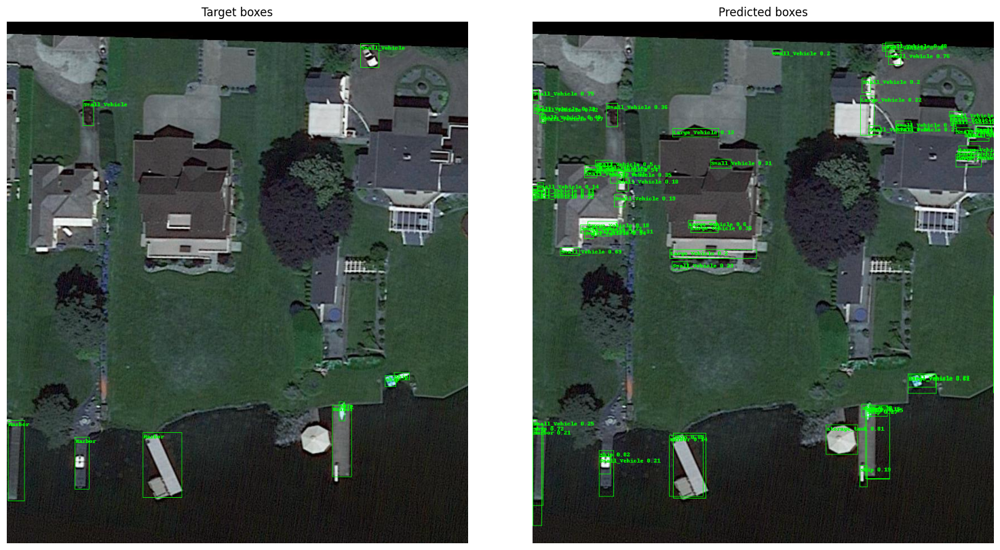

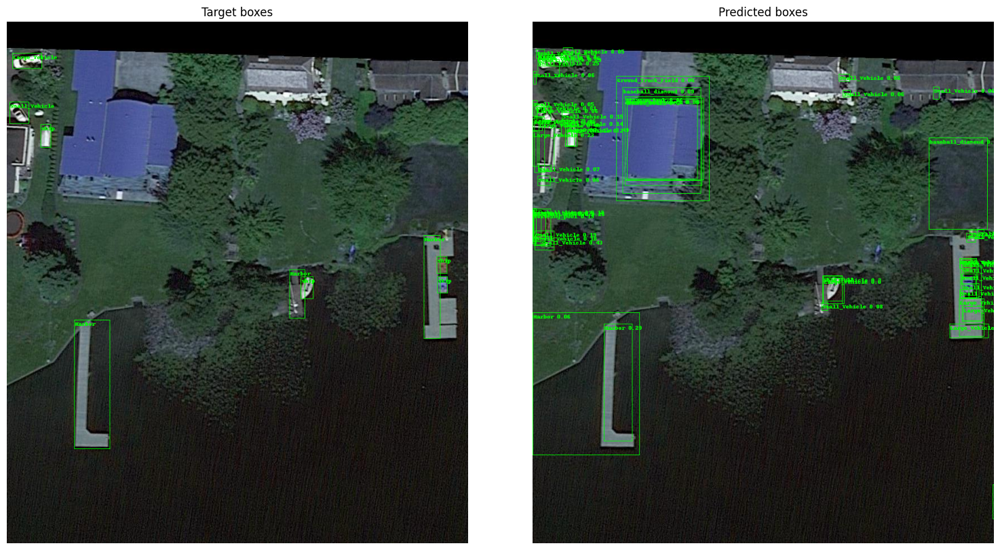

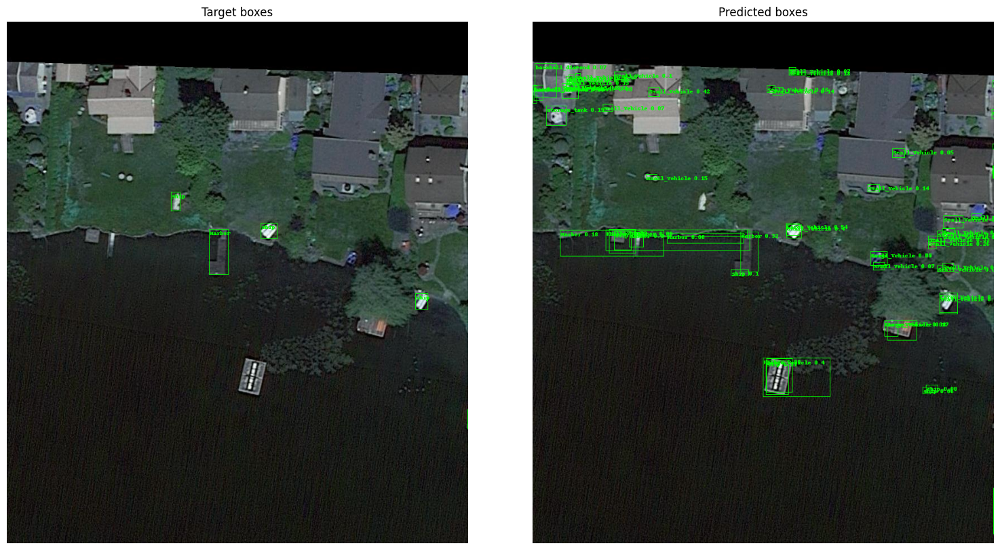

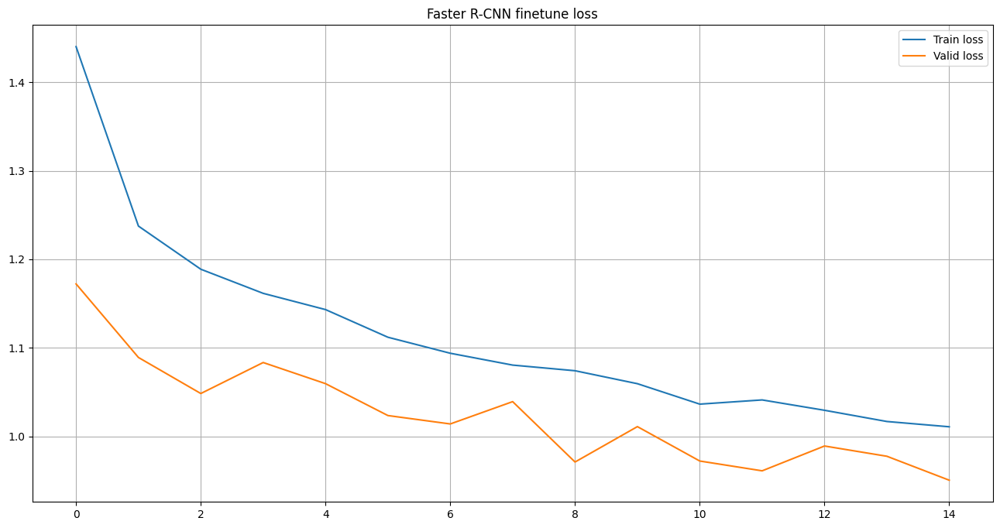

In [28]:
whole_train_valid_cycle(model, 15, 'Faster R-CNN finetune')
torch.save(model.state_dict(), '/kaggle/working/fasterrcnn_with_aug.pth')

Метрики модели:

In [19]:
model = get_detection_model().to(device)
model.load_state_dict(torch.load('/kaggle/input/model-1/fasterrcnn_with_aug.pth'))

Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth
100%|██████████| 74.2M/74.2M [00:00<00:00, 163MB/s]


<All keys matched successfully>

In [22]:
valid_map = evaluate(model, valid_loader)
valid_map

Evaluation:   0%|          | 0/327 [00:00<?, ?it/s]

{'map': tensor(0.1709),
 'map_50': tensor(0.3280),
 'map_75': tensor(0.1604),
 'map_small': tensor(0.0318),
 'map_medium': tensor(0.1476),
 'map_large': tensor(0.2769),
 'mar_1': tensor(0.0893),
 'mar_10': tensor(0.2062),
 'mar_100': tensor(0.2412),
 'mar_small': tensor(0.0590),
 'mar_medium': tensor(0.2138),
 'mar_large': tensor(0.3418),
 'map_per_class': tensor([0.1308, 0.0756, 0.0078, 0.3717, 0.0701, 0.0789, 0.1981, 0.6290, 0.1406,
         0.1313, 0.3201, 0.0559, 0.1373, 0.1599, 0.0570]),
 'mar_100_per_class': tensor([0.1703, 0.1391, 0.0308, 0.4360, 0.1268, 0.1309, 0.2874, 0.6656, 0.2380,
         0.2256, 0.4368, 0.1429, 0.2186, 0.2347, 0.1337]),
 'classes': tensor([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15],
        dtype=torch.int32)}

In [24]:
print('mAP for class')
for i in range(len(valid_map['map_per_class'])):
    map_class = valid_map['map_per_class'][i].item()
    print(f'class: {idx2target[i+1]}; map: {map_class}')

mAP for class
class: storage_tank; map: 0.1307530254125595
class: Large_Vehicle; map: 0.07555977255105972
class: Small_Vehicle; map: 0.0077814157120883465
class: plane; map: 0.3717094957828522
class: ship; map: 0.07007419317960739
class: Swimming_pool; map: 0.07894245535135269
class: Harbor; map: 0.1981077641248703
class: tennis_court; map: 0.6289615631103516
class: Ground_Track_Field; map: 0.14062196016311646
class: Soccer_ball_field; map: 0.131255105137825
class: baseball_diamond; map: 0.3201054334640503
class: Bridge; map: 0.05586674436926842
class: basketball_court; map: 0.13727012276649475
class: Roundabout; map: 0.1599060446023941
class: Helicopter; map: 0.05695290490984917


Модель с trainable_backbone_layers=6:

In [21]:
model = get_detection_model(trainable_backbone_layers=6).to(device)

optimizer = torch.optim.Adam([p for p in model.parameters() if p.requires_grad], lr=1e-4)

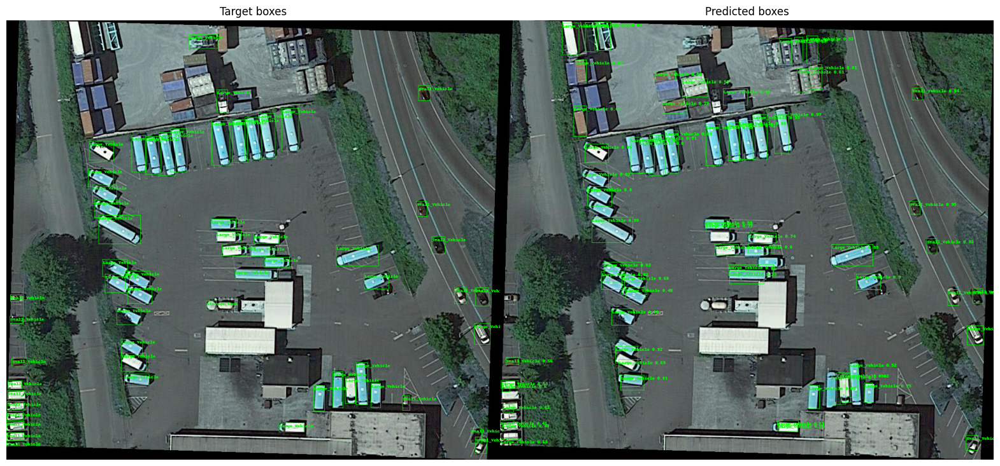

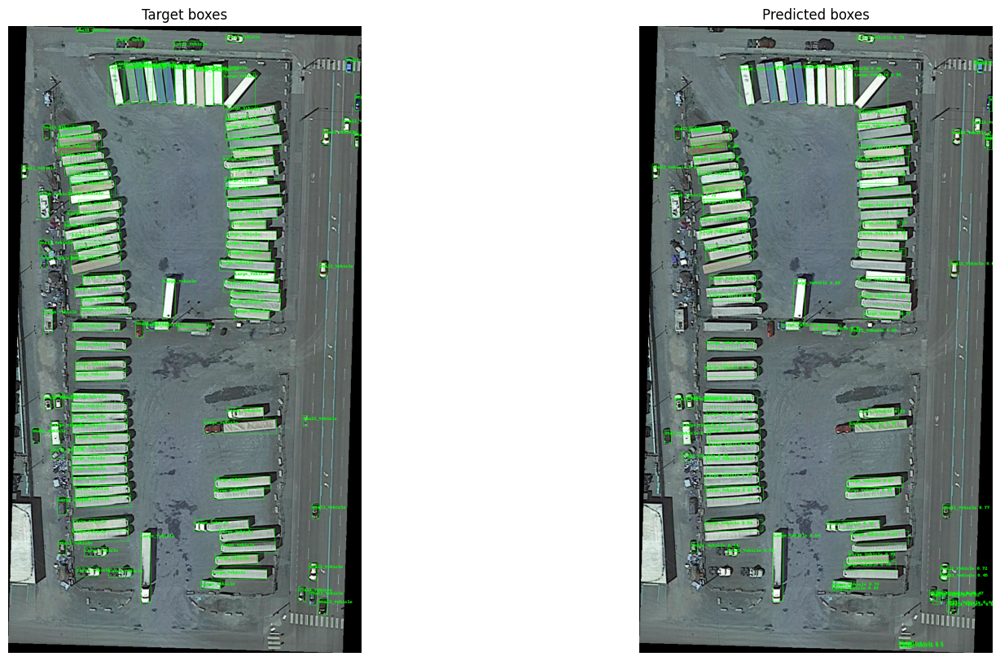

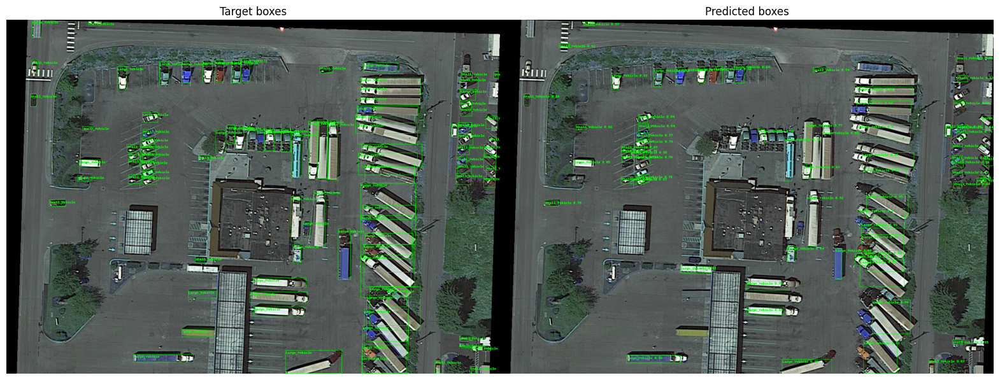

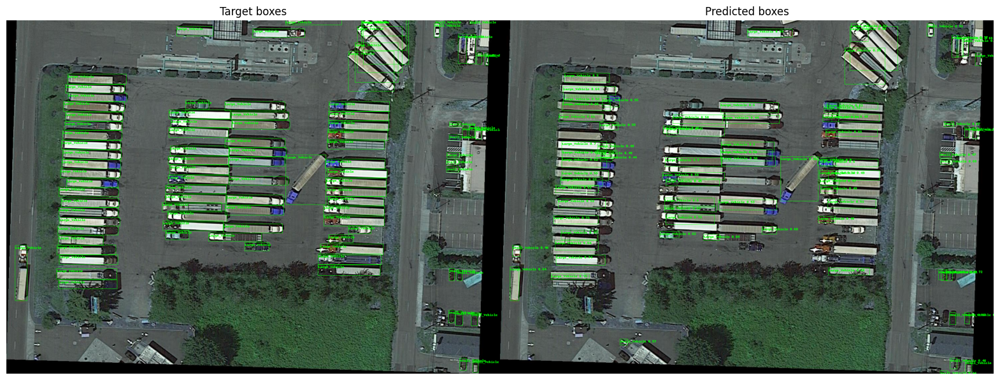

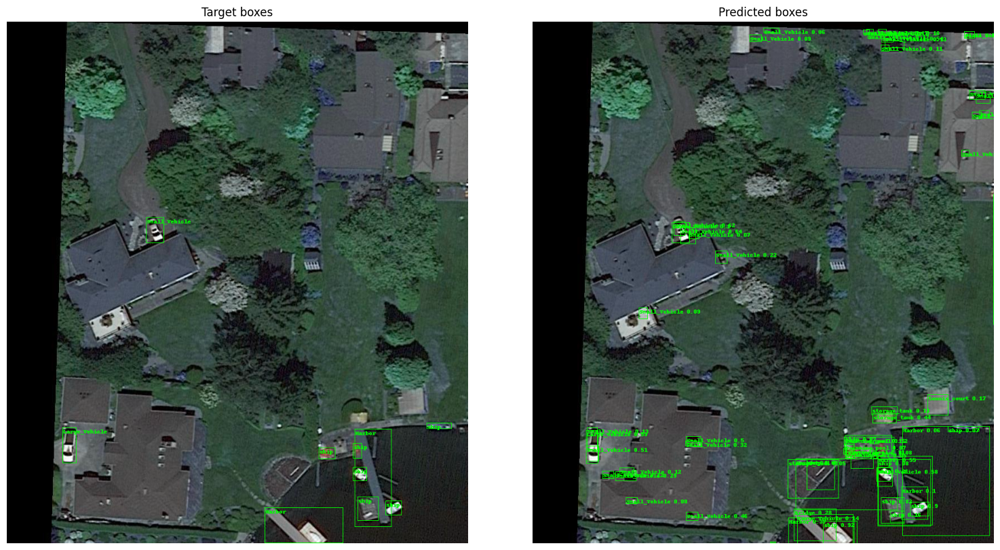

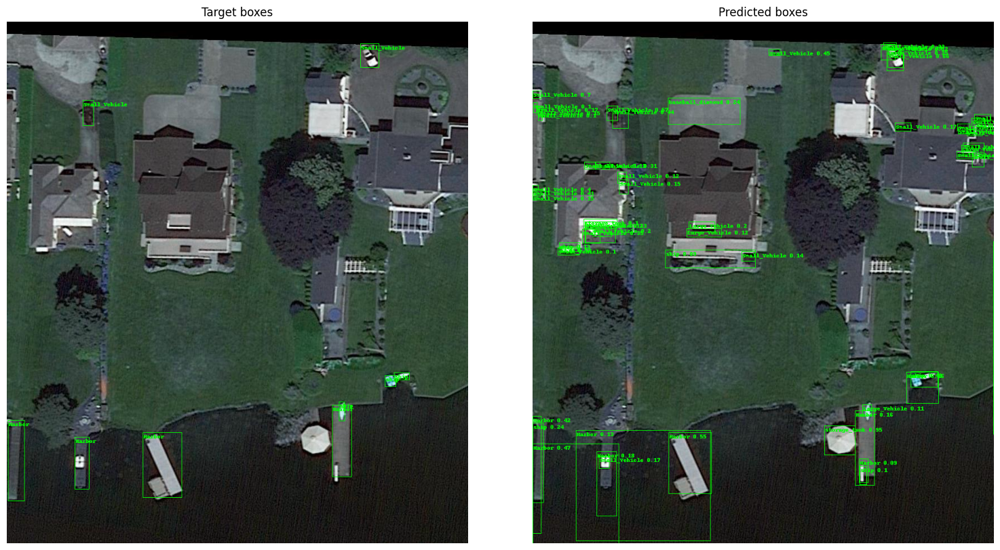

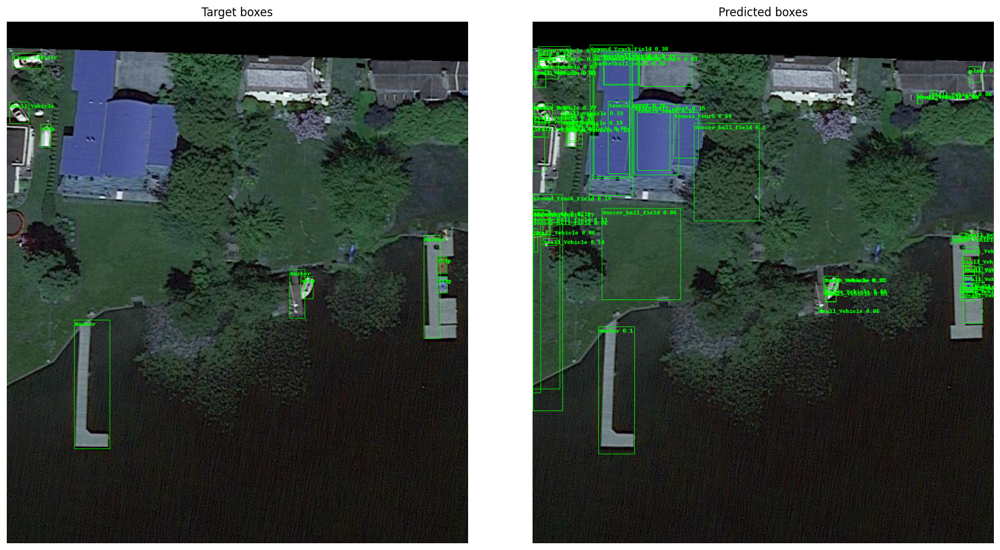

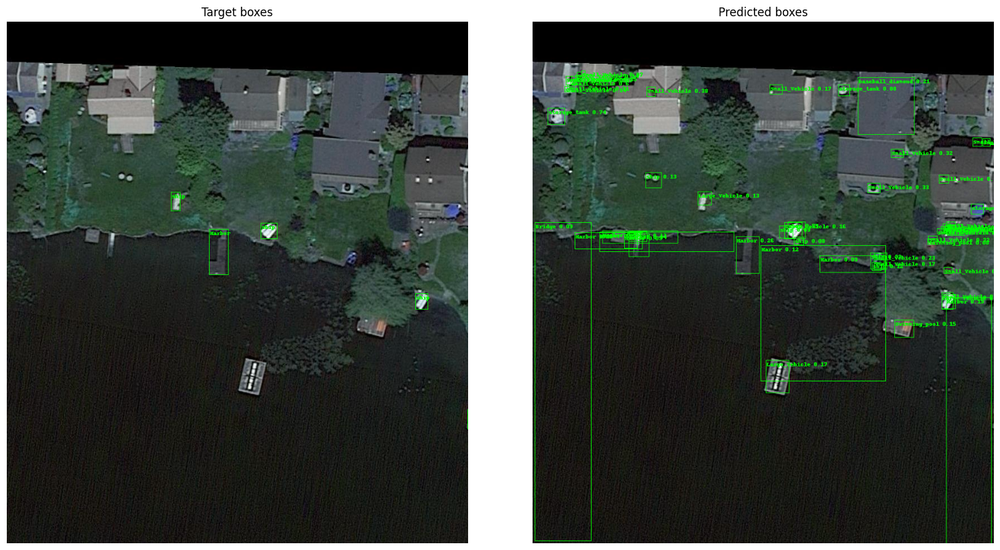

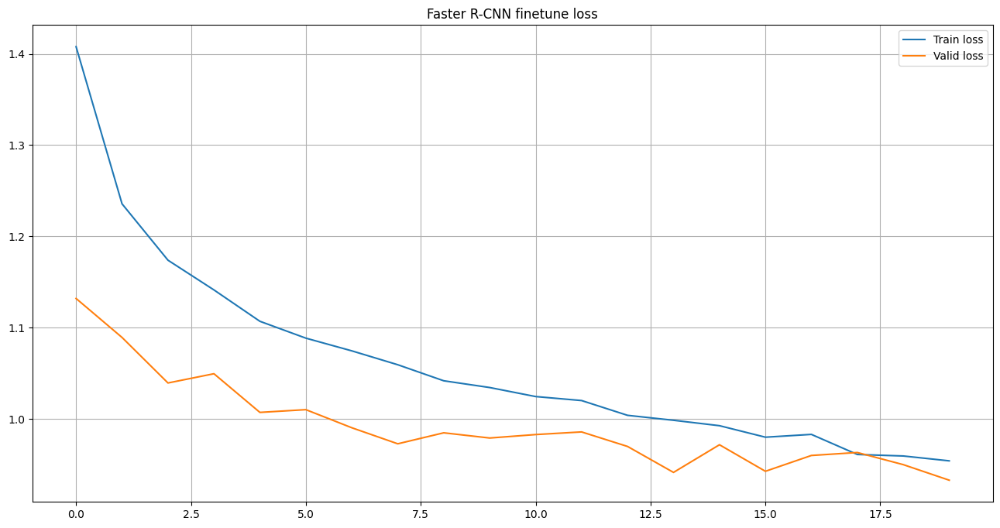

In [22]:
whole_train_valid_cycle(model, 20, 'Faster R-CNN finetune')
torch.save(model.state_dict(), '/kaggle/working/fasterrcnn_train_all.pth')

Метрики модели:

In [25]:
model = get_detection_model(trainable_backbone_layers=6).to(device)
model.load_state_dict(torch.load('/kaggle/input/model-2/fasterrcnn_with_aug_train_all.pth'))

<All keys matched successfully>

In [26]:
valid_map = evaluate(model, valid_loader)
valid_map

Evaluation:   0%|          | 0/327 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/torchmetrics/utilities/prints.py:43: UserWarning: Encountered more than 100 detections in a single image. This means that certain detections with the lowest scores will be ignored, that may have an undesirable impact on performance. Please consider adjusting the `max_detection_threshold` to suit your use case. To disable this warning, set attribute class `warn_on_many_detections=False`, after initializing the metric.
  warnings.warn(*args, **kwargs)  # noqa: B028


{'map': tensor(0.1717),
 'map_50': tensor(0.3446),
 'map_75': tensor(0.1503),
 'map_small': tensor(0.0360),
 'map_medium': tensor(0.1538),
 'map_large': tensor(0.2816),
 'mar_1': tensor(0.0898),
 'mar_10': tensor(0.2068),
 'mar_100': tensor(0.2450),
 'mar_small': tensor(0.0737),
 'mar_medium': tensor(0.2218),
 'mar_large': tensor(0.3427),
 'map_per_class': tensor([0.1352, 0.0762, 0.0115, 0.4228, 0.0750, 0.1138, 0.2132, 0.6425, 0.1657,
         0.1302, 0.2570, 0.0613, 0.0935, 0.1456, 0.0322]),
 'mar_100_per_class': tensor([0.1729, 0.1406, 0.0384, 0.4894, 0.1360, 0.1775, 0.3034, 0.6821, 0.2742,
         0.2489, 0.3702, 0.1491, 0.1633, 0.2203, 0.1084]),
 'classes': tensor([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15],
        dtype=torch.int32)}

In [27]:
print('mAP for class')
for i in range(len(valid_map['map_per_class'])):
    map_class = valid_map['map_per_class'][i].item()
    print(f'class: {idx2target[i+1]}; map: {map_class}')

mAP for class
class: storage_tank; map: 0.13521964848041534
class: Large_Vehicle; map: 0.07622238248586655
class: Small_Vehicle; map: 0.011504811234772205
class: plane; map: 0.4227946102619171
class: ship; map: 0.07498224824666977
class: Swimming_pool; map: 0.11382883042097092
class: Harbor; map: 0.21320493519306183
class: tennis_court; map: 0.6425210237503052
class: Ground_Track_Field; map: 0.16572807729244232
class: Soccer_ball_field; map: 0.1302313357591629
class: baseball_diamond; map: 0.25697389245033264
class: Bridge; map: 0.06125583499670029
class: basketball_court; map: 0.09352929890155792
class: Roundabout; map: 0.14563338458538055
class: Helicopter; map: 0.032217901200056076


> Итак, что можно сказать? С мозаичной аугметацией модель переобучается не так быстро, однако и качество она показывает меньше.